# Installing dependencies

In [ ]:
!apt install tesseract-ocr libtesseract-dev

In [4]:
!pip install Levenshtein jiwer

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 161.7/161.7 kB 4.2 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 48.1 MB/s eta 0:00:00a 0:00:01


# Tesseract OCR on warped vs flat image

In [5]:
import pytesseract
from PIL import Image

filepath = "/kaggle/input/dir300/DIR300/dist/1.png"
scan_filepath = "/kaggle/input/dir300/DIR300/gt/1.png"

with Image.open(filepath) as our_img:
    OCR_text = pytesseract.image_to_string(our_img, config="--oem 1")
with Image.open(scan_filepath) as scan_img:
    GT_text = pytesseract.image_to_string(scan_img, config="--oem 1")

print("\n Warped:")
print(OCR_text)
print("\n Flat:")
print(GT_text)


 Warped:
=

THAT WORD YOU Tava

Spanish, t
clear: penitent, re}
penitentes are jagge
their resemblance to the
worn by some Catholics Spain.
fs Researchers believe they form in snowy
it's sunny but still cold, li
summer. Because of the ary

warms too much doesn't melt; it vaP
factors may also play a role, ts this vaporizing that
ite stuff into the characteristic

whittles the remaining wh
points of penitentes.
Earth might not eve!
spot them. Astronomers sus
Jupiter's moon Europa have
peaks. — LACY SCHLEY; ILLUSTRATION BY CH

n be the only place you could
pect that both Pluto and
their own versions of the

AD EDWARDS

14 DISCOVERMAGAZINE.COM

 


 Flat:
  

Penitentes

If you speak Spanish, this word's religious meaning is
clear: penitent, or repentant. In scientific circles, though,
penitentes are jagged snow formations, named after
their resemblance to the white, pointed hoods once
worn by some Catholics in Spain.

Researchers believe they form in snowy areas where
it's sunny but sti

## Visual observation

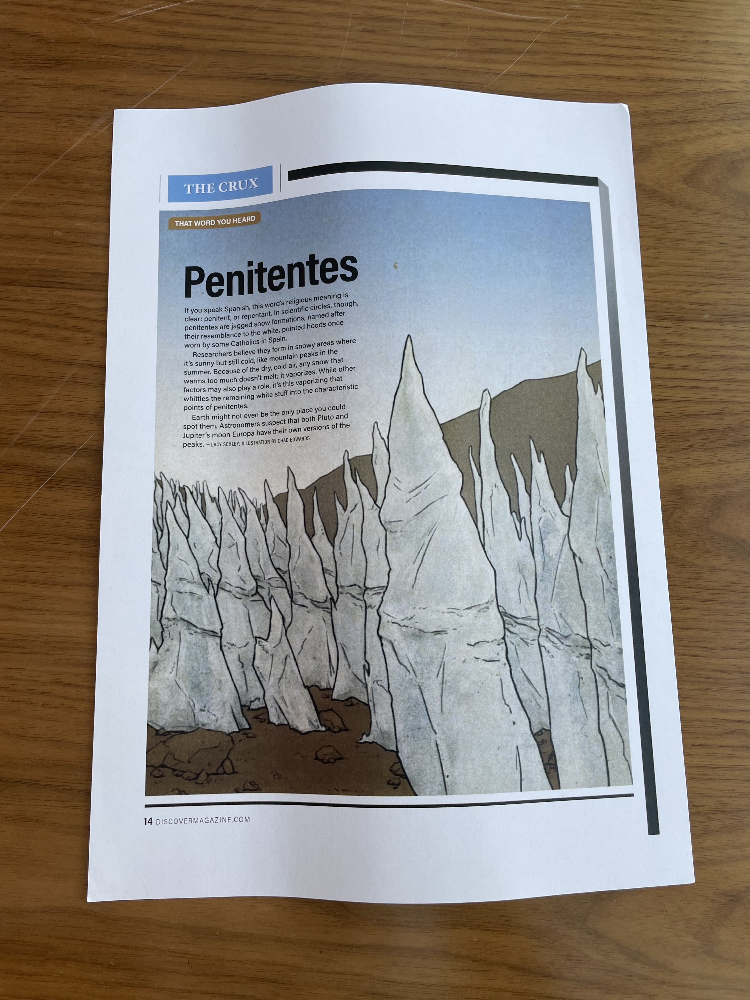

In [8]:
Image.open(filepath)

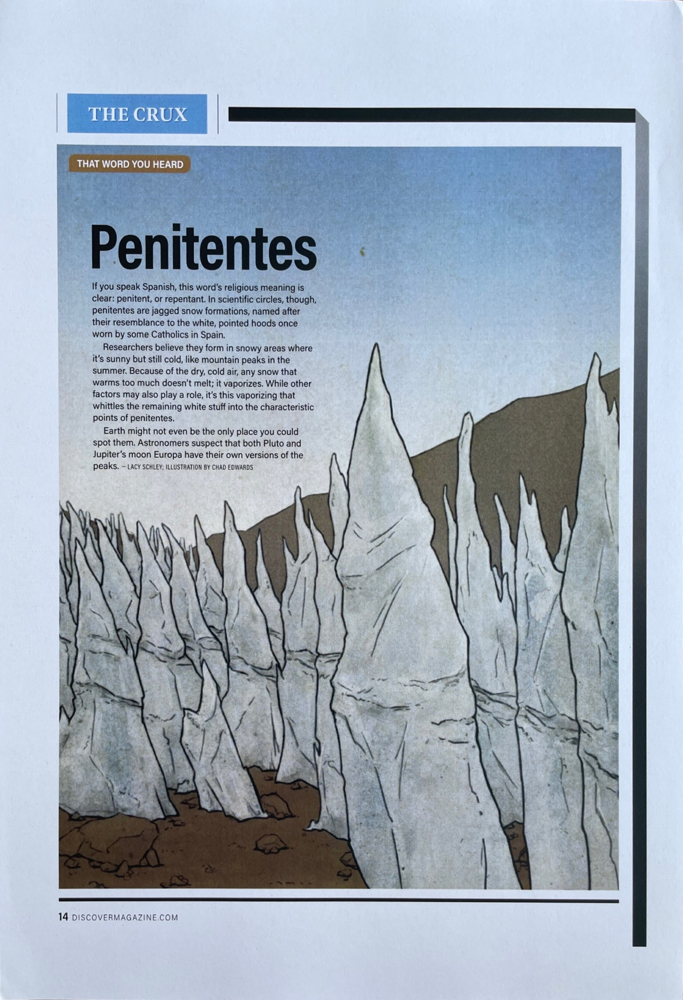

In [9]:
Image.open(scan_filepath)

## CER and ED metric calculation

In [15]:
import Levenshtein as lv
from jiwer import cer

CER = cer(GT_text, OCR_text)
ED = lv.distance(OCR_text, GT_text)
CER, ED

(0.5149082568807339, 454)

# PDF generation

In [6]:
!pip install reportlab Pillow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 20.2 MB/s eta 0:00:00a 0:00:01


In [7]:
from reportlab.pdfgen import canvas
from reportlab.lib.pagesizes import letter, A4
from reportlab.lib.utils import ImageReader
from reportlab.pdfbase import pdfmetrics
from reportlab.pdfbase.ttfonts import TTFont
from PIL import Image
import json

def generate_pdf_from_extraction(text_data, image_data, output_filename="output.pdf"):
    """
    Generate a PDF from extracted text and images with bounding boxes
    
    Args:
        text_data: List of dictionaries containing text and bounding box info
                   Example: [{"text": "Hello", "bbox": [x0, y0, x1, y1], "font": "Helvetica", "size": 12}]
        image_data: List of dictionaries containing image paths and bounding boxes
                   Example: [{"path": "image1.png", "bbox": [x0, y0, x1, y1]}]
        output_filename: Name of the output PDF file
    """
    # Create a PDF canvas
    c = canvas.Canvas(output_filename, pagesize=A4)
    width, height = A4
    
    # Process images first (so text appears on top)
    for img_info in image_data:
        path = img_info["path"]
        bbox = img_info["bbox"]
        
        # Open and process the image
        pil_image = Image.open(path)
        img_reader = ImageReader(pil_image)
        
        # Calculate position and size
        x0, y0, x1, y1 = bbox
        img_width = x1 - x0
        img_height = y1 - y0
        
        # Draw image at the specified position
        # Note: PDF coordinates have origin at bottom-left, so we flip y-axis
        c.drawImage(img_reader, x0, height - y1, width=img_width, height=img_height, preserveAspectRatio=True)
    
    # Process text elements
    for text_info in text_data:
        text = text_info["text"]
        bbox = text_info["bbox"]
        font = text_info.get("font", "Helvetica")
        size = text_info.get("size", 12)
        
        # Set font
        c.setFont(font, size)
        
        # Calculate position (convert from top-left to bottom-left origin)
        x0, y0, x1, y1 = bbox
        text_width = x1 - x0
        text_height = y1 - y0
        
        # Draw text at the specified position
        # Note: We need to handle text wrapping if the text exceeds the bounding box width
        text_object = c.beginText(x0, height - y1 - text_height)
        text_object.setFont(font, size)
        
        # Simple text wrapping within the bounding box
        words = text.split()
        line = []
        line_width = 0
        space_width = c.stringWidth(" ", font, size)
        
        for word in words:
            word_width = c.stringWidth(word, font, size)
            if line_width + word_width + (len(line) * space_width) <= text_width:
                line.append(word)
                line_width += word_width
            else:
                # Draw the current line and start a new one
                text_object.textLine(" ".join(line))
                line = [word]
                line_width = word_width
        
        # Draw the last line
        if line:
            text_object.textLine(" ".join(line))
        
        c.drawText(text_object)
    
    # Save the PDF
    c.save()

## Step 1. Extracting bounding boxes

In [8]:
import pytesseract
from PIL import Image

# Load the image
img = Image.open(scan_filepath)

# Get the OCR data including bounding boxes
data = pytesseract.image_to_data(img, output_type=pytesseract.Output.DATAFRAME)

sample_text_data = []
sample_image_data = []
for index, row in data.iterrows():
    if row['conf'] > 0:  # Filter out low-confidence detections
        x, y, w, h = row['left'], row['top'], row['width'], row['height']
        text = row['text']
        print(f"Text: '{text}', Bounding Box: (x={x}, y={y}, w={w}, h={h})")
        sample_text_data.append(
            {
                "text": text,
                "bbox": [x, y, x+w, y+h],  # x0, y0, x1, y1
                "font": "Helvetica",
                "size": 16
            }
        )

Text: '  ', Bounding Box: (x=128, y=233, w=1546, h=539)
Text: 'Penitentes', Bounding Box: (x=235, y=510, w=579, h=185)
Text: 'If', Bounding Box: (x=238, y=725, w=12, h=19)
Text: 'you', Bounding Box: (x=256, y=730, w=36, h=19)
Text: 'speak', Bounding Box: (x=300, y=726, w=60, h=23)
Text: 'Spanish,', Bounding Box: (x=367, y=726, w=87, h=24)
Text: 'this', Bounding Box: (x=460, y=727, w=37, h=19)
Text: 'word's', Bounding Box: (x=504, y=728, w=66, h=19)
Text: 'religious', Bounding Box: (x=578, y=728, w=85, h=24)
Text: 'meaning', Bounding Box: (x=671, y=728, w=88, h=24)
Text: 'is', Bounding Box: (x=767, y=728, w=15, h=20)
Text: 'clear:', Bounding Box: (x=237, y=756, w=56, h=19)
Text: 'penitent,', Bounding Box: (x=301, y=756, w=89, h=23)
Text: 'or', Bounding Box: (x=398, y=762, w=20, h=14)
Text: 'repentant.', Bounding Box: (x=425, y=760, w=103, h=21)
Text: 'In', Bounding Box: (x=536, y=759, w=17, h=18)
Text: 'scientific', Bounding Box: (x=561, y=758, w=91, h=20)
Text: 'circles,', Bounding Box

## Step 2. Combining extracted text into PDF

In [ ]:
# sample_text_data = [
#     {
#         "text": "This is a sample document title",
#         "bbox": [50, 750, 300, 780],  # x0, y0, x1, y1
#         "font": "Helvetica-Bold",
#         "size": 16
#     },
#     {
#         "text": "This is the first paragraph of the sample document. It contains multiple sentences to demonstrate text wrapping within the specified bounding box.",
#         "bbox": [50, 650, 350, 730],
#         "font": "Helvetica",
#         "size": 12
#     }
# ]

# sample_image_data = [
#     {
#         "path": "/kaggle/input/dir300/DIR300/dist/1.png",  # Path to your extracted image
#         "bbox": [400, 650, 550, 800]  # x0, y0, x1, y1
#     }
# ]


In [10]:
sample_text_data[:10]

[{'text': '  ',
  'bbox': [128, 233, 1674, 772],
  'font': 'Helvetica',
  'size': 16},
 {'text': 'Penitentes',
  'bbox': [235, 510, 814, 695],
  'font': 'Helvetica',
  'size': 16},
 {'text': 'If', 'bbox': [238, 725, 250, 744], 'font': 'Helvetica', 'size': 16},
 {'text': 'you',
  'bbox': [256, 730, 292, 749],
  'font': 'Helvetica',
  'size': 16},
 {'text': 'speak',
  'bbox': [300, 726, 360, 749],
  'font': 'Helvetica',
  'size': 16},
 {'text': 'Spanish,',
  'bbox': [367, 726, 454, 750],
  'font': 'Helvetica',
  'size': 16},
 {'text': 'this',
  'bbox': [460, 727, 497, 746],
  'font': 'Helvetica',
  'size': 16},
 {'text': "word's",
  'bbox': [504, 728, 570, 747],
  'font': 'Helvetica',
  'size': 16},
 {'text': 'religious',
  'bbox': [578, 728, 663, 752],
  'font': 'Helvetica',
  'size': 16},
 {'text': 'meaning',
  'bbox': [671, 728, 759, 752],
  'font': 'Helvetica',
  'size': 16}]

In [9]:
generate_pdf_from_extraction(sample_text_data[:10], sample_image_data, "generated_document.pdf")